In [1]:
import numpy as np
import scipy

import cupy as cp
import cupyx.scipy

import astropy.units as u
from astropy.io import fits
from matplotlib.patches import Rectangle, Circle
from pathlib import Path
from IPython.display import clear_output, display, HTML
display(HTML("<style>.container { width:90% !important; }</style>")) # just making the notebook cells wider
from datetime import datetime
today = int(datetime.today().strftime('%Y%m%d'))

from importlib import reload
import time

import logging, sys
poppy_log = logging.getLogger('poppy')
poppy_log.setLevel('DEBUG')
logging.basicConfig(stream=sys.stdout, level=logging.INFO)

poppy_log.disabled = True

import warnings
warnings.filterwarnings("ignore")

import cgi_phasec_poppy

import ray
if not ray.is_initialized():
    ray.init(log_to_driver=False)
    
from math_module import xp, ensure_np_array
import iefc_2dm 
import utils
from imshows import *

from emccd_detect import emccd_detect
meta_path = Path('/home/kianmilani/Projects/emccd_detect/emccd_detect/emccd_detect/util/metadata.yaml')

dm1_flat = fits.getdata(cgi_phasec_poppy.data_dir/'dm-acts'/'flatmaps'/'spc_wide_band4_flattened_dm1.fits')
dm2_flat = fits.getdata(cgi_phasec_poppy.data_dir/'dm-acts'/'flatmaps'/'spc_wide_band4_flattened_dm2.fits')

data_dir = iefc_2dm.iefc_data_dir
response_dir = data_dir/'response-data'


INFO:numexpr.utils:Note: NumExpr detected 64 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
INFO:numexpr.utils:NumExpr defaulting to 8 threads.


2024-01-08 09:46:45,764	INFO worker.py:1636 -- Started a local Ray instance.


1.3624486320346218e-17 sr
	Flux for wavelength 8.130e-07 m: 3.998e+08 ph / (s m2)
	Flux for wavelength 8.250e-07 m: 3.840e+08 ph / (s m2)
	Flux for wavelength 8.370e-07 m: 3.691e+08 ph / (s m2)
Total flux: 1.153e+09 ph / (s m2)


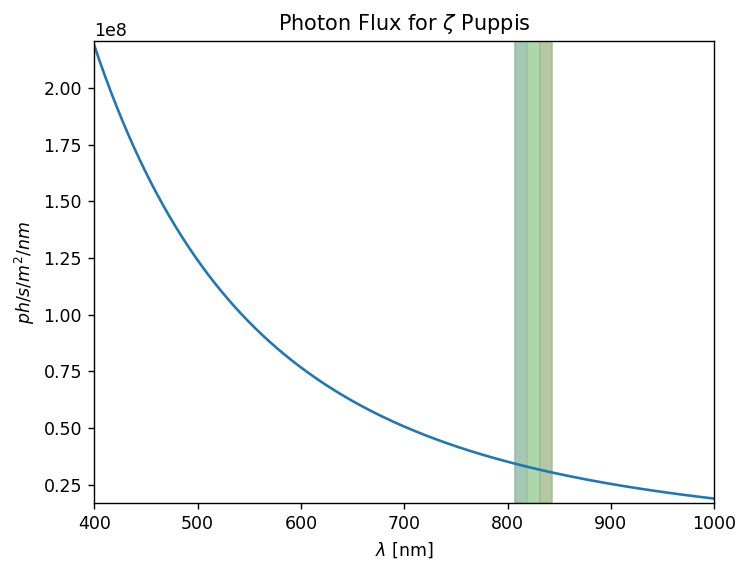

In [2]:
reload(cgi_phasec_poppy.source_flux)

wavelength_c = 825e-9*u.m

nwaves = 3
bandwidth = 2.9/100
minwave = wavelength_c * (1 - bandwidth/2)
maxwave = wavelength_c * (1 + bandwidth/2)
wavelengths = np.linspace( minwave, maxwave, nwaves )

minlam = 400*u.nm
maxlam = 1000*u.nm
nlam = int((maxlam-minlam).value*20) + 1
lambdas = np.linspace(minlam, maxlam, nlam)

from astropy.constants import h, c, k_B, R_sun

zpup = cgi_phasec_poppy.source_flux.SOURCE(wavelengths=wavelengths,
                                            temp=40000*u.K,
                                            distance=300*u.parsec,
                                            diameter=2*14*R_sun,
                                            name='$\zeta$ Puppis', 
                                            lambdas=lambdas,
                                           )

zpup.plot_spectrum_ph()
source_fluxes = zpup.calc_fluxes()
total_flux = np.sum(source_fluxes)

for i,flux in enumerate(source_fluxes):
    print(f'\tFlux for wavelength {wavelengths[i]:.3e}: {flux:.3e}')
print(f'Total flux: {total_flux:.3e}')

In [3]:
reload(cgi_phasec_poppy.cgi)
reload(cgi_phasec_poppy.parallelized_cgi)

rayCGI = ray.remote(cgi_phasec_poppy.cgi.CGI) # make a ray actor class from the original CGI class  

kwargs = {
    'cgi_mode':'spc-wide',
    'npsf':150,
    'use_pupil_defocus':True,
    'use_opds':True,
    'polaxis':0,
}

actors = []
for i in range(nwaves):
    actors.append(rayCGI.options(num_cpus=2, num_gpus=1/8).remote(**kwargs))
    actors[i].setattr.remote('wavelength', wavelengths[i])
    actors[i].setattr.remote('source_flux', source_fluxes[i])

In [4]:
em_gain = 200
full_well_image=60000.  # e-
full_well_serial=100000.  # e-
#status=1,
dark_current=0.0028  # e-/pix/s
dark_current=8e-4  # e-/pix/s
cic=0.01  # e-/pix/frame
read_noise=120.  # e-/pix/frame
bias=500.  # e-
qe=0.5
cr_rate=0.  # hits/cm^2/s
pixel_pitch=13e-6  # m
eperdn=1 #7.,
nbits=16
numel_gain_register=604

emccd = emccd_detect.EMCCDDetect(em_gain=em_gain,
                                    full_well_image=full_well_image,  # e-
                                    full_well_serial=full_well_serial,  # e-
                                    #status=status,
                                    dark_current=dark_current,  # e-/pix/s
                                    cic=cic,  # e-/pix/frame
                                    read_noise=read_noise,  # e-/pix/frame
                                    bias=bias,  # e-
                                    qe=qe,
                                    cr_rate=cr_rate,  # hits/cm^2/s
                                    pixel_pitch=pixel_pitch,  # m
                                    eperdn=eperdn,
                                    nbits=nbits,
                                    numel_gain_register=numel_gain_register,
                                    meta_path=meta_path
                                    )

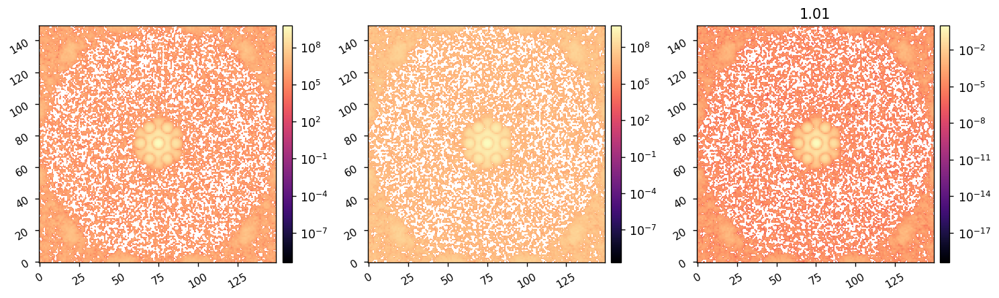

Computing each monochromatic image.


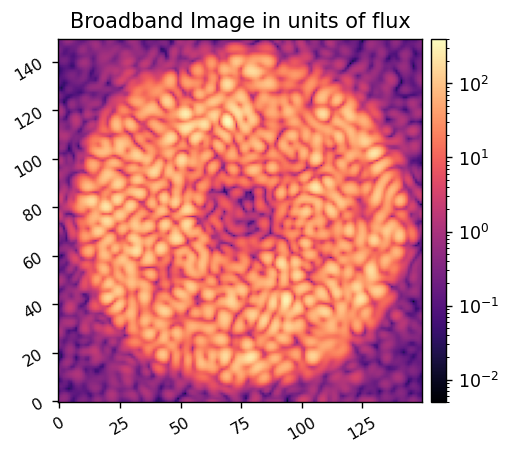

Generating all frames based on computed flux for exposure time 1/3


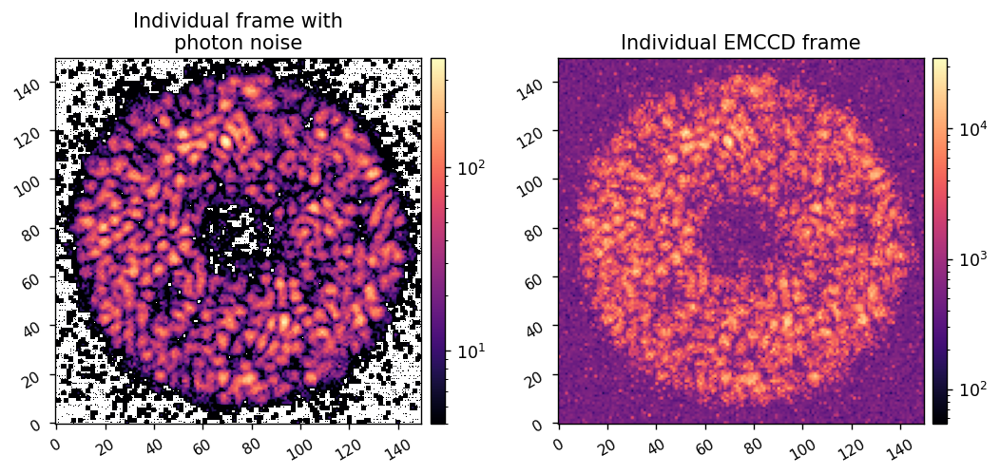

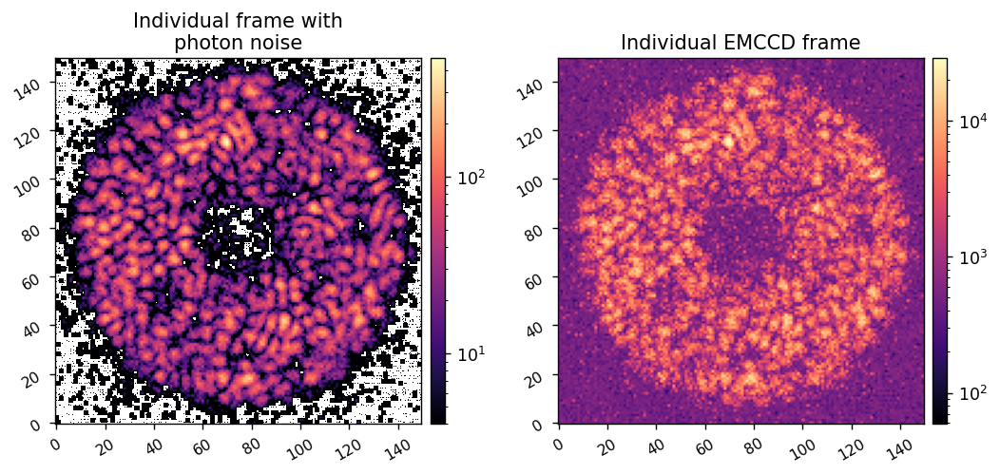

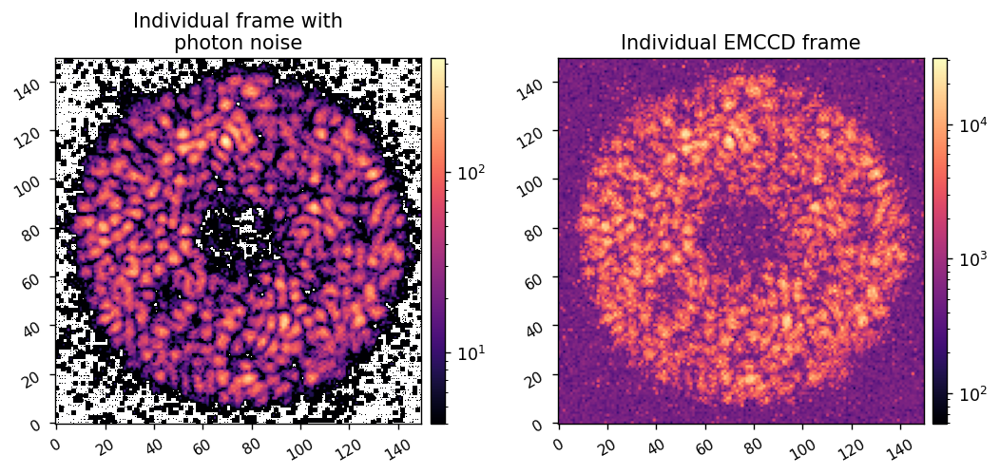

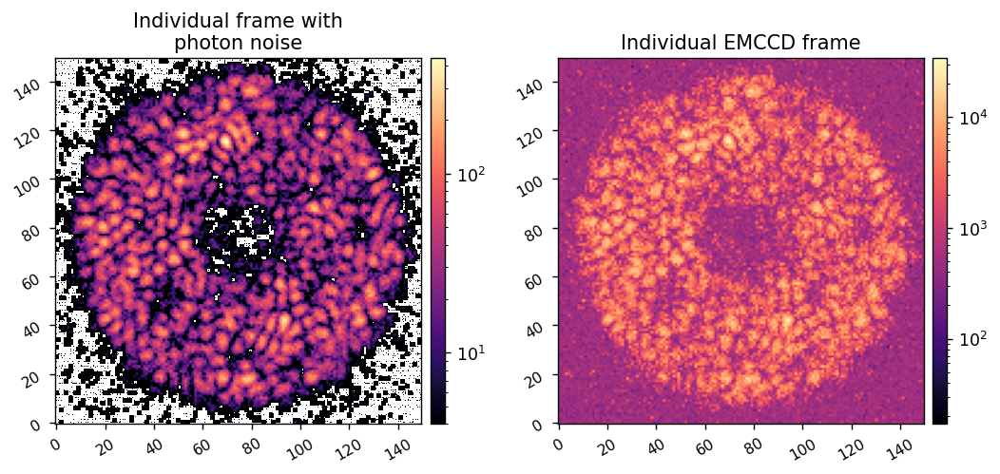

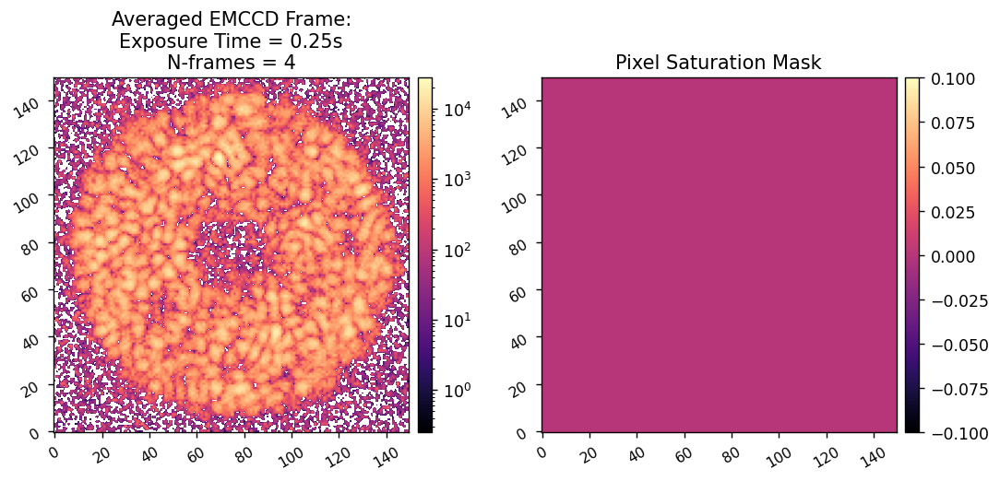

Generating all frames based on computed flux for exposure time 2/3


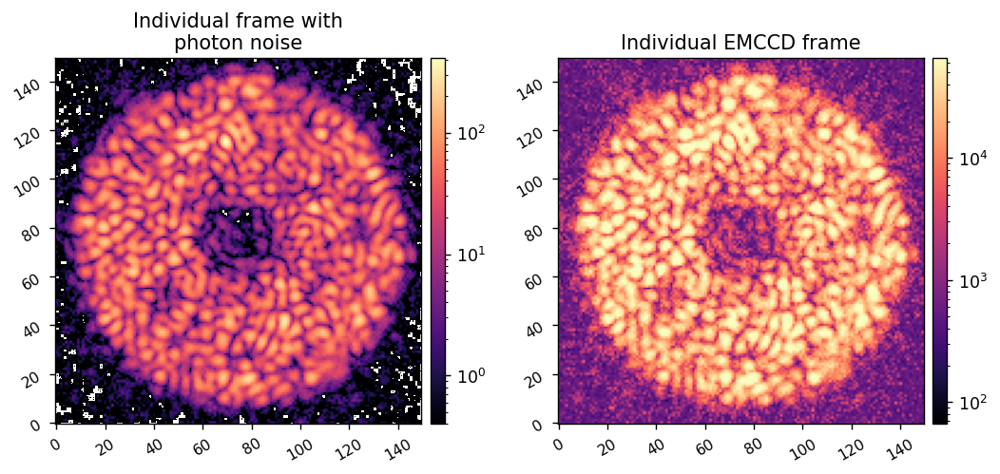

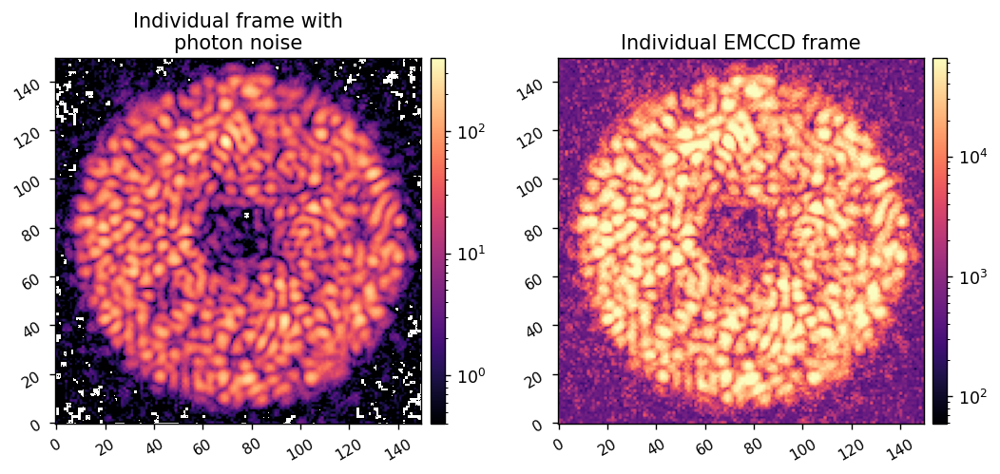

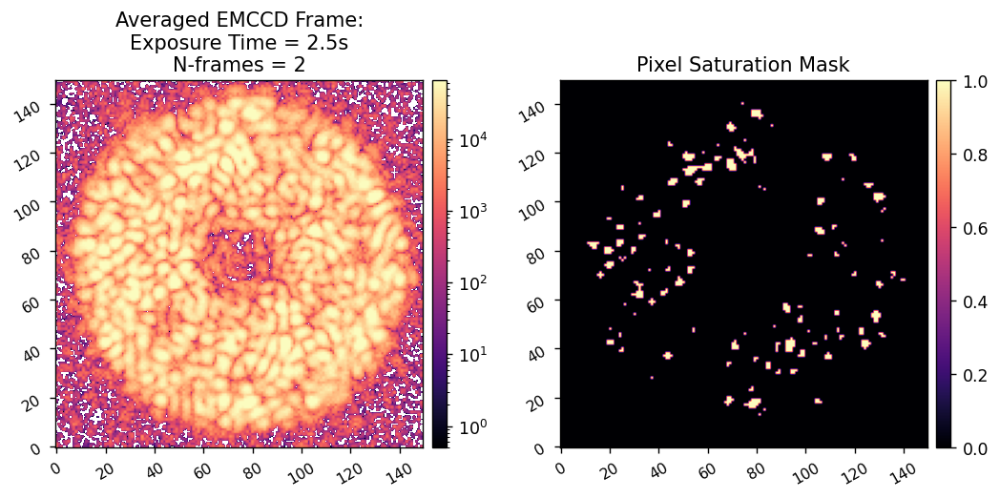

Generating all frames based on computed flux for exposure time 3/3


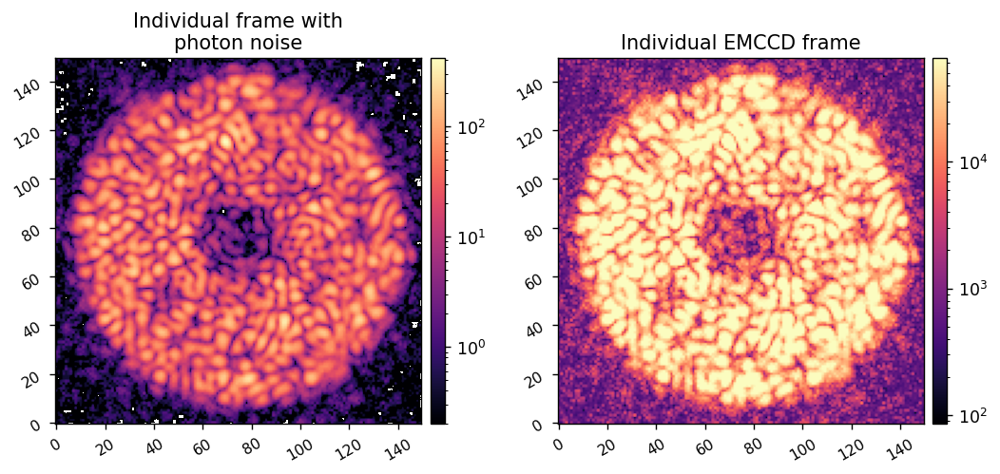

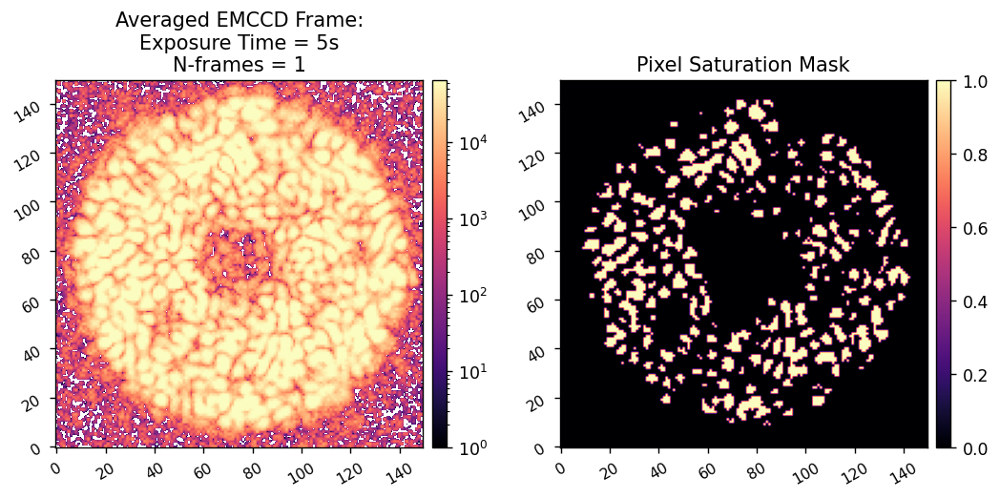

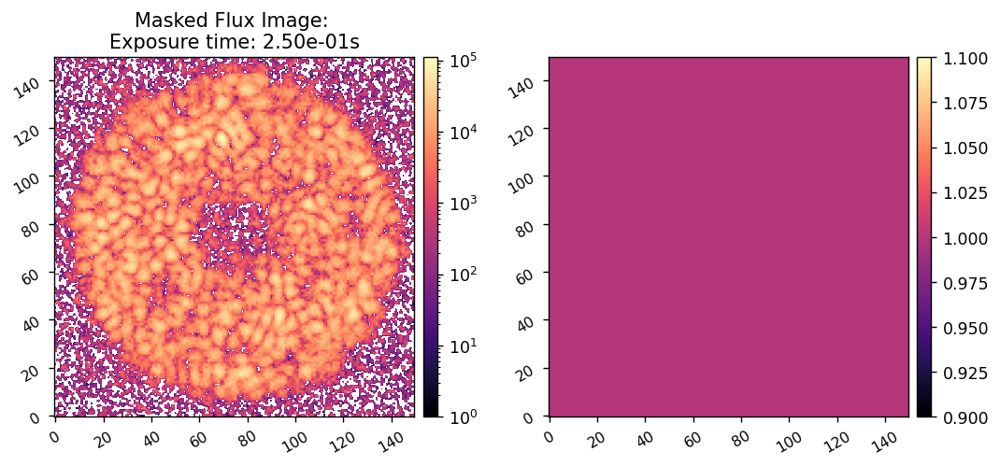

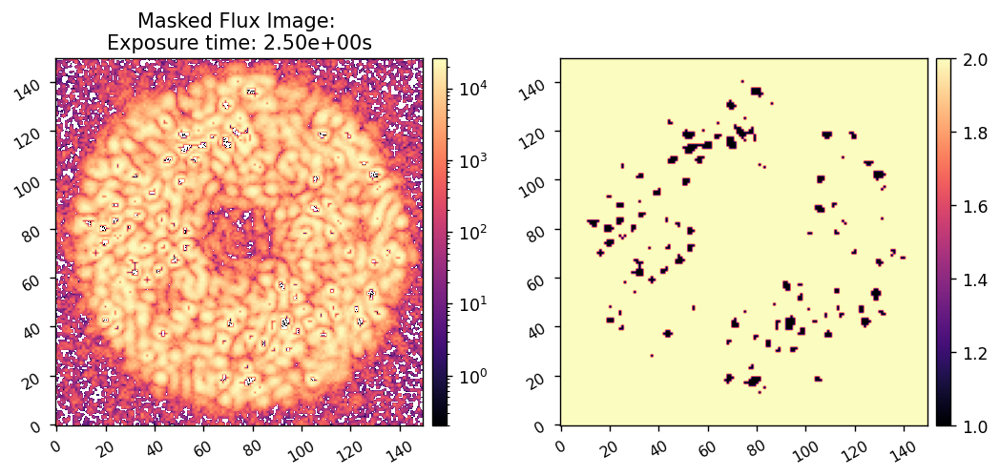

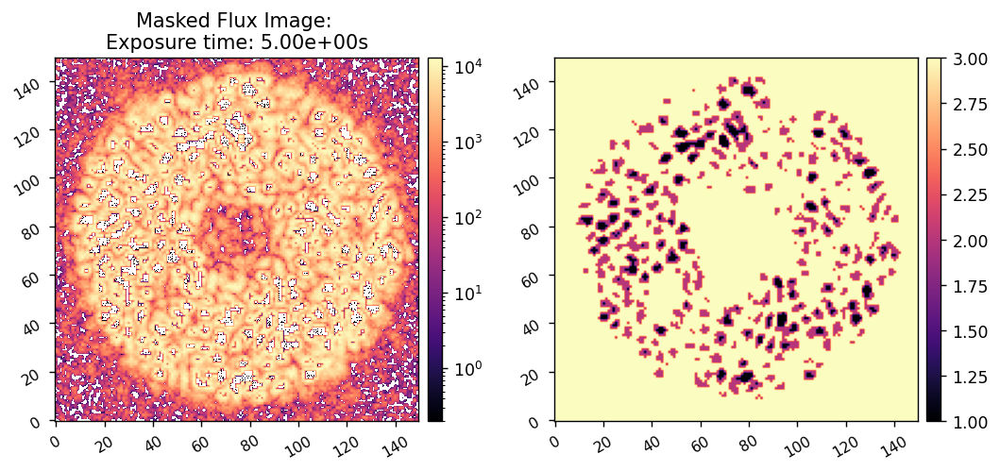

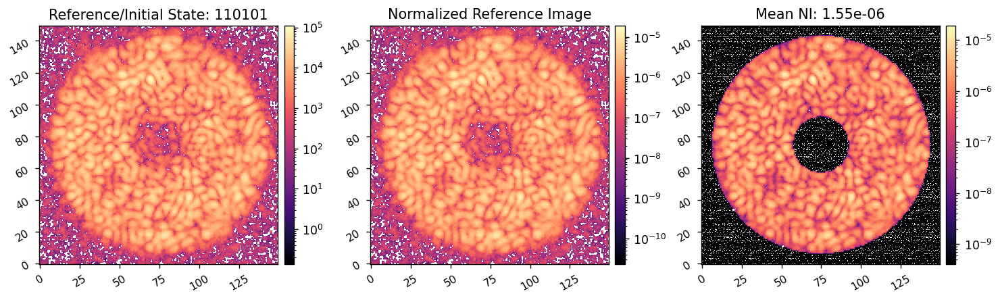

In [5]:
reload(cgi_phasec_poppy.parallelized_cgi)
mode = cgi_phasec_poppy.parallelized_cgi.ParallelizedCGI(actors=actors, dm1_ref=dm1_flat, dm2_ref=dm2_flat)

mode.EMCCD = emccd

unocc_em_gain = 500

mode.set_actor_attr('use_fpm',False)
mode.Nframes = 10
mode.EMCCD.em_gain = unocc_em_gain

mode.exp_times_list = [0.00001, 0.00005, 0.0001]
mode.subtract_bias = True
raw_im = mode.snap_many()

mode.normalize = True
mode.Imax_ref = xp.max(raw_im.max())
mode.em_gain_ref = unocc_em_gain

ref_unocc_im = mode.snap_many()
imshow3(raw_im, ref_unocc_im/mode.norm_factor, ref_unocc_im, 
        '', '', f'{xp.max(ref_unocc_im):.2f}', lognorm=True)

mode.EMCCD.em_gain = 500

mode.set_actor_attr('use_fpm',True)
mode.exp_times_list = [0.25,2.5,5]
mode.Nframes_list = [4, 2, 1]
ref_im = mode.snap_many(quiet=False, plot=True)

control_mask = utils.create_annular_focal_plane_mask(mode, inner_radius=5.4, outer_radius=20.6, edge=None)
mean_ni = xp.mean(ref_im[control_mask])
imshow3(ref_im/mode.norm_factor, ref_im, ref_im*control_mask, 
        f'Reference/Initial State: {xp.max(ref_im/mode.norm_factor):.0f}', 
        'Normalized Reference Image',
        f'Mean NI: {mean_ni:.2e}',
        lognorm=True,)


# Create calibration and probe modes

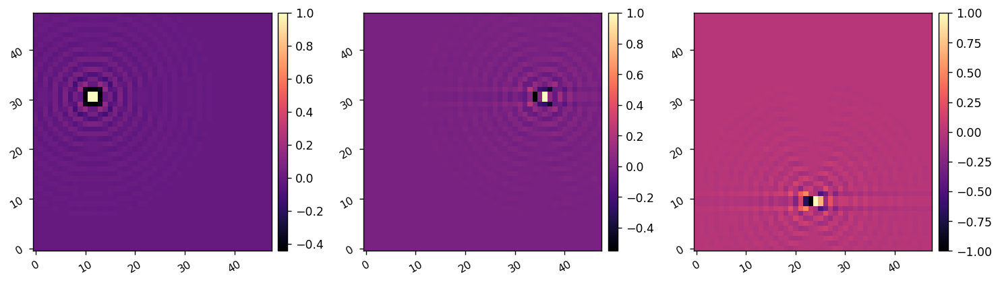

In [7]:
probe_modes = utils.create_fourier_probes(mode, control_mask, fourier_sampling=0.5,
                                          shift=[(-12,7), (12,7),(0,-14), (0,0)], nprobes=3,
                                           use_weighting=True,)

imshow3(probe_modes[0], probe_modes[1], probe_modes[2])

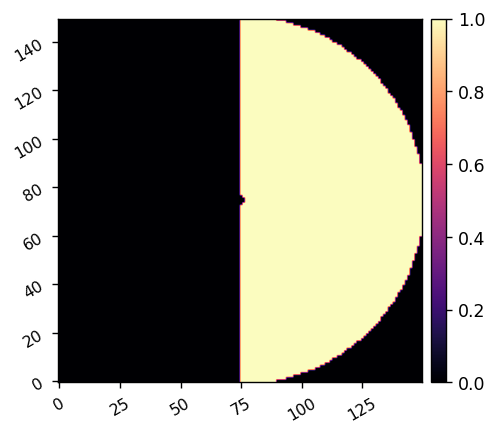

(3480, 4608)


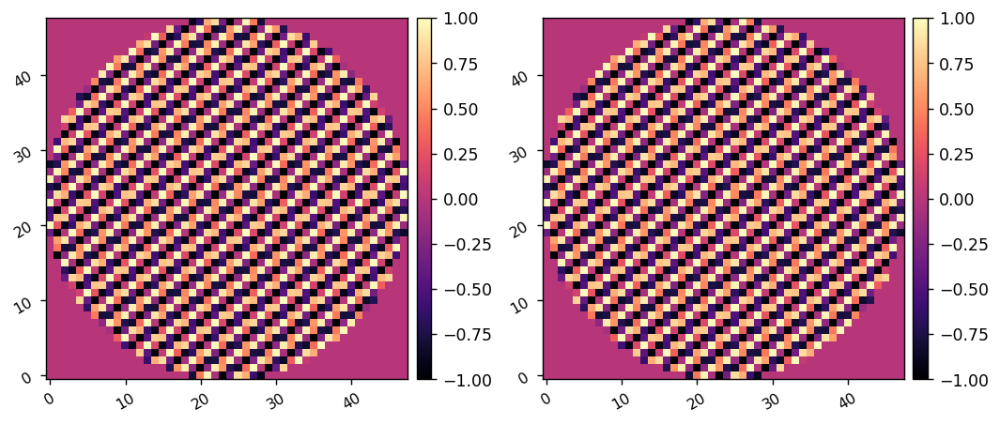

(3480, 4608)


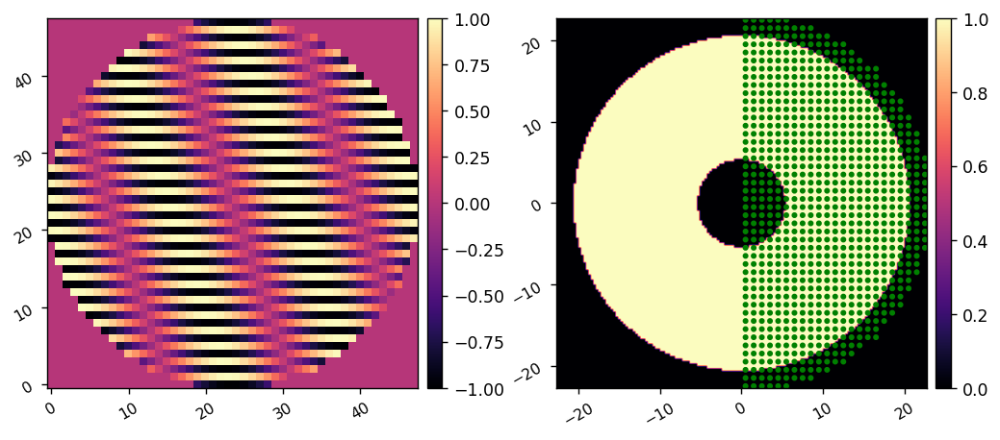

In [34]:
fourier_mask = utils.create_annular_focal_plane_mask(mode, inner_radius=0.5, outer_radius=23, edge=0, plot=True)
calib_modes, fs = utils.create_fourier_modes(mode, fourier_mask, fourier_sampling=1, ndms=2, return_fs=True)
fs = np.concatenate([fs, fs, fs, fs])
Nfourier = calib_modes.shape[0]//2
print(calib_modes.shape)
i = 100
imshow2(calib_modes[i,:mode.Nact**2].reshape(mode.Nact,mode.Nact), 
        calib_modes[i+Nfourier,mode.Nact**2:].reshape(mode.Nact,mode.Nact))

patches = []
for f in fs[:Nfourier//2]:
    center = (f[0], f[1])
    radius = 0.25
    patches.append(Circle(center, radius, fill=True, color='g'))
print(calib_modes.shape)
imshow2(calib_modes[1, :mode.Nact**2].reshape(mode.Nact,mode.Nact), control_mask, 
             patches2=patches, pxscl2=mode.psf_pixelscale_lamD)

In [41]:
calib_modes.shape[0]//2/2

870.0

In [38]:
fs.shape

(870, 2)

In [13]:
4/(1/5)

20.0

In [38]:
reload(utils)

scale_factors = []
for i in range(fs.shape[0]):
    mode_extent = xp.sqrt(fs[i][0]**2 + fs[i][1]**2)
    if mode_extent<2:
        factor = 20
    elif mode_extent>2 and mode_extent<3:
        factor = 5
    elif mode_extent>3 and mode_extent<4:
        factor = 3.75
    elif mode_extent>4 and mode_extent<6:
        factor = 2
    elif mode_extent>6 and mode_extent<9:
        factor = 1
    elif mode_extent>9 and mode_extent<10:
        factor = 1
    elif mode_extent>10 and mode_extent<15:
        factor = 1
    elif mode_extent>15 and mode_extent<18:
        factor = 1
    elif mode_extent>18 and mode_extent<20:
        factor = 1.666
    elif mode_extent>20 and mode_extent<22:
        factor = 2.5
    elif mode_extent>22 and mode_extent<23:
        factor = 5
    elif mode_extent>23:
        factor = 10
    scale_factors.append(factor)
scale_factors = np.array(scale_factors)

scale_factors = np.concatenate([scale_factors,scale_factors, scale_factors, scale_factors])
print(scale_factors.shape)

(13920,)


(3480,)


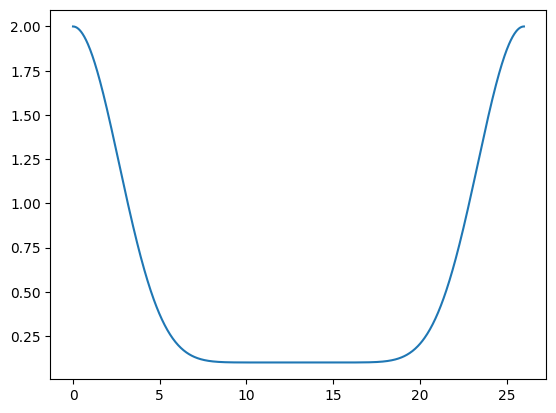

In [47]:
fmax = 26
x = np.linspace(0,fmax, 1000)
min_scale_factor = 1/10
max_scale_factor = 2
factors = (max_scale_factor - min_scale_factor)*np.cos(2*np.pi/fmax/2*x)**10 + min_scale_factor

plt.plot(x, factors)

scale_factors = []
for i in range(fs.shape[0]):
    mode_extent = np.sqrt(fs[i][0]**2 + fs[i][1]**2)
    closest_index = np.argmin(np.abs(x-mode_extent))
    scale_factors.append(factors[closest_index])
scale_factors = np.array(scale_factors)
scale_factors = np.concatenate([scale_factors,scale_factors, scale_factors, scale_factors])
print(scale_factors.shape)

In [39]:
Nmodes = response_matrix.shape[1]
count = 0
sat_mode_inds = []
for i in range(Nmodes): 
    if xp.max(xp.isnan(response_matrix[:,i])):
        count += 1
        sat_mode_inds.append(i)
        print('\t',i, fs[i],)
print(count)


	 293 [ 1.5 -5.5]
	 318 [ 3.5 -4.5]
	 343 [ 4.5 -3.5]
	 392 [ 5.5 -1.5]
	 440 [5.5 0.5]
	 464 [5.5 1.5]
	 511 [4.5 3.5]
	 534 [3.5 4.5]
	 556 [1.5 5.5]
	 1163 [ 1.5 -5.5]
	 1188 [ 3.5 -4.5]
	 1213 [ 4.5 -3.5]
	 1262 [ 5.5 -1.5]
	 1310 [5.5 0.5]
	 1334 [5.5 1.5]
	 1381 [4.5 3.5]
	 1404 [3.5 4.5]
	 1426 [1.5 5.5]
	 2033 [ 1.5 -5.5]
	 2058 [ 3.5 -4.5]
	 2083 [ 4.5 -3.5]
	 2132 [ 5.5 -1.5]
	 2180 [5.5 0.5]
	 2204 [5.5 1.5]
	 2251 [4.5 3.5]
	 2274 [3.5 4.5]
	 2296 [1.5 5.5]
	 2903 [ 1.5 -5.5]
	 2928 [ 3.5 -4.5]
	 2953 [ 4.5 -3.5]
	 3002 [ 5.5 -1.5]
	 3050 [5.5 0.5]
	 3074 [5.5 1.5]
	 3121 [4.5 3.5]
	 3144 [3.5 4.5]
	 3166 [1.5 5.5]
36


In [44]:
calib_modes.shape

(3480, 4608)

Total exposure time: 0.50s


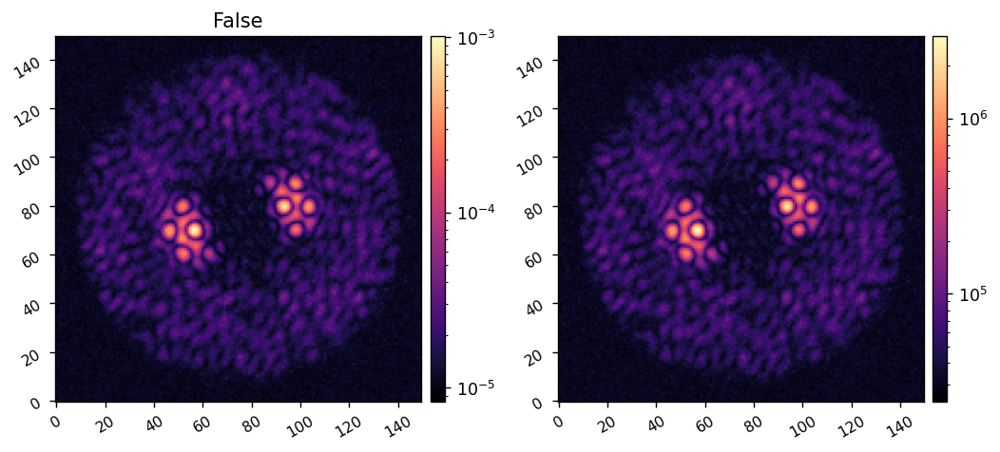

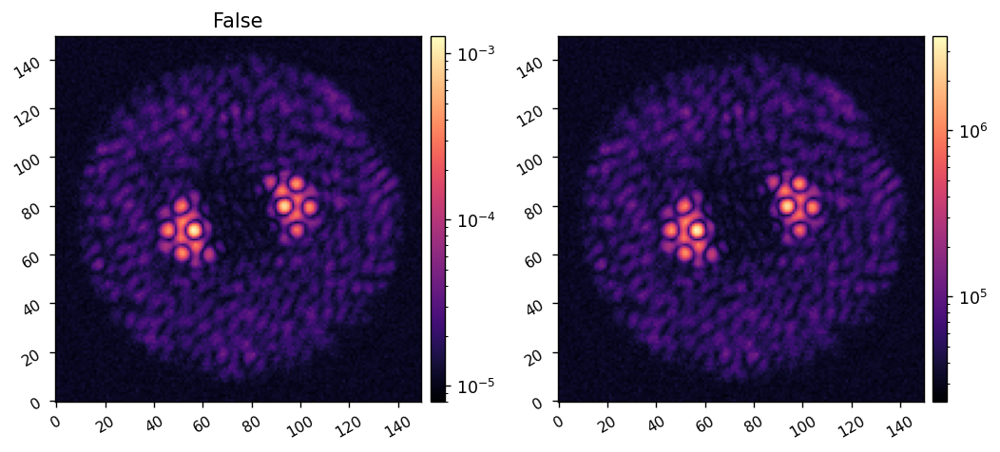

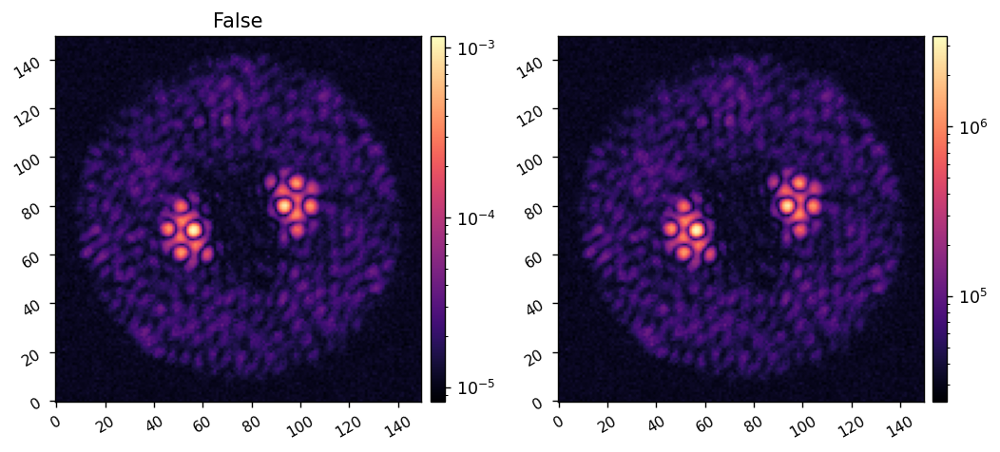

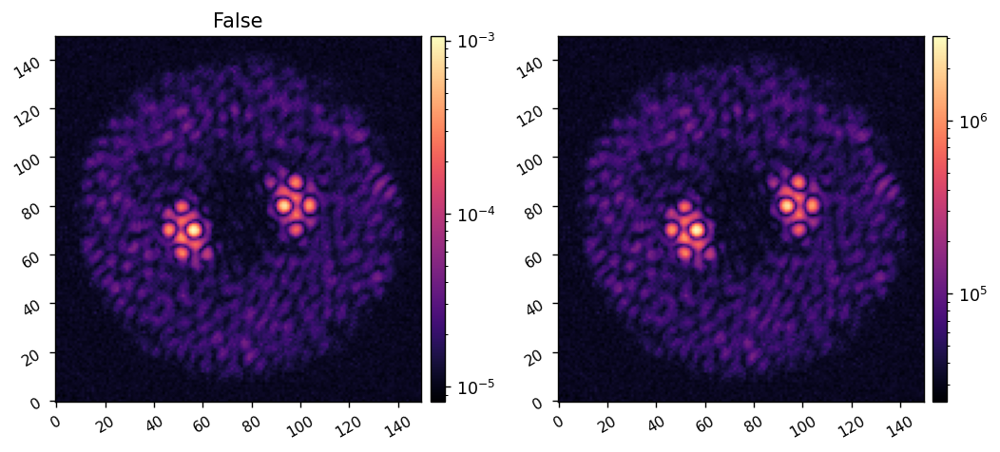

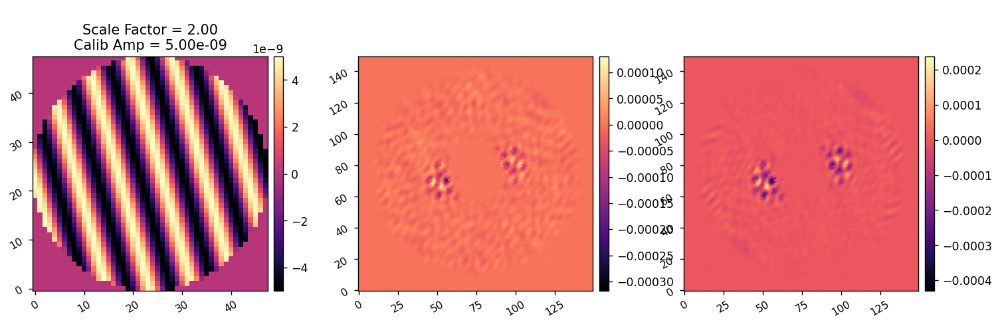

...

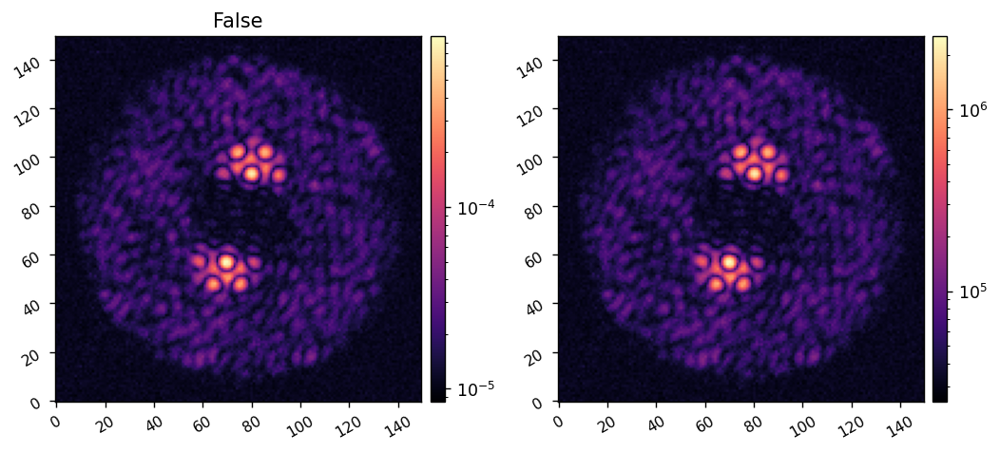

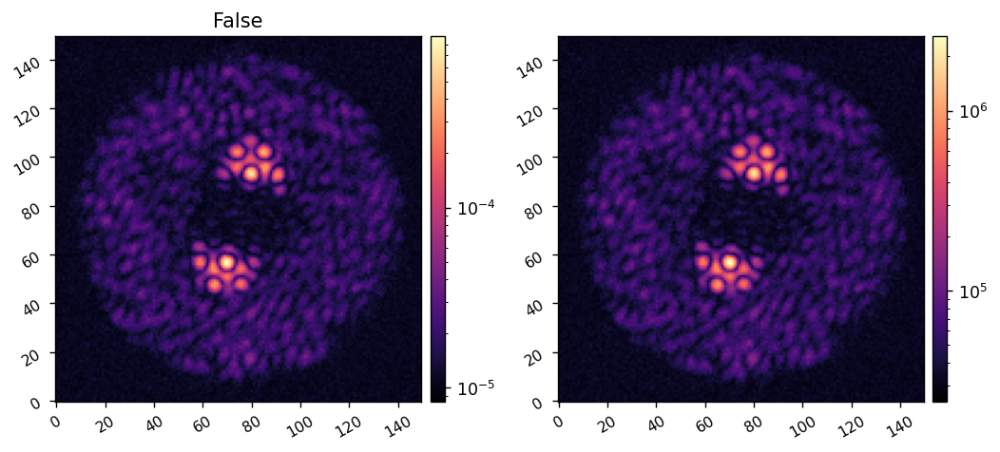

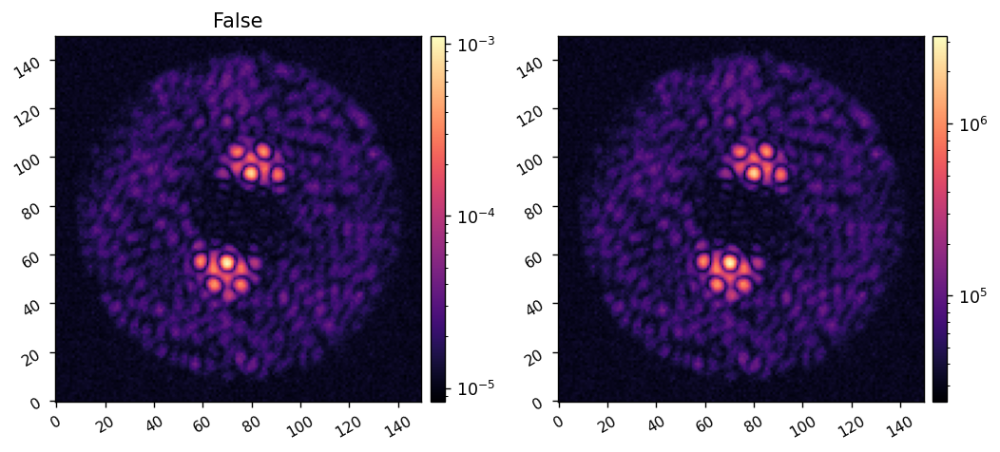

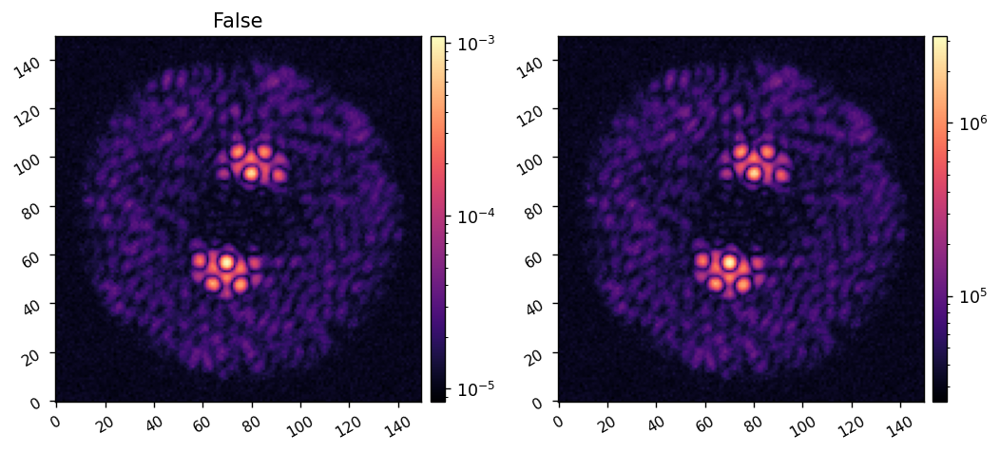

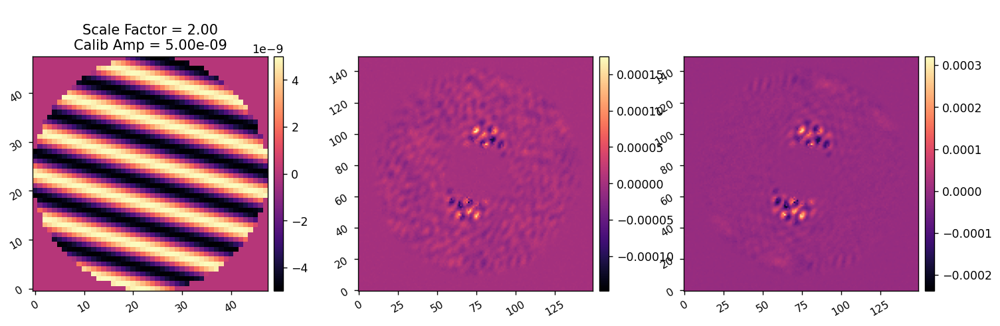

In [47]:
mode.reset_dms()
mode.subtract_bias = False
mode.EMCCD.em_gain = 250
mode.exp_times_list = np.array([0.01, 0.05, 0.25, 0.5])/2
mode.Nframes_list = np.array([10, 3, 1, 1])

total_exp_time = np.sum(mode.exp_times_list*mode.Nframes_list)
print(f'Total exposure time: {total_exp_time:.2f}s')

calib_amp = 2.5e-9
probe_amp = 20e-9

# mode.add_dm1(probe_amp*probe_modes[0])
# probed_im1 = mode.snap_many(exp_times)
# mode.add_dm1(-probe_amp*probe_modes[0])

# mode.add_dm1(-probe_amp*probe_modes[0])
# probed_im2 = mode.snap_many(exp_times)
# mode.add_dm1(probe_amp*probe_modes[0])

# ref_diff = probed_im1-probed_im2
# imshow3(probed_im1, probed_im2, ref_diff, 
#         f'{xp.max(probed_im1):.0f}', f'{xp.max(probed_im2):.0f}', 
#           lognorm1=True, lognorm2=True)

# for i in range(425, 432):
for i in sat_mode_inds[32:36]:
        dm1_mode = calib_modes[i,:mode.Nact**2].reshape(mode.Nact,mode.Nact)
        dm2_mode = calib_modes[i,mode.Nact**2:].reshape(mode.Nact,mode.Nact)
        scaled_calib_amp = calib_amp * scale_factors[i]
        # print(scale_factors[i], scaled_calib_amp)

        # mode.add_dm1(scaled_calib_amp*dm_mode)
        # mode.add_dm1(probe_amp*probe_modes[0])
        # im1 = mode.snap()
        # mode.add_dm1(-probe_amp*probe_modes[0])
        # mode.add_dm1(-scaled_calib_amp*dm_mode)

        mode.add_dm1(scaled_calib_amp*dm1_mode)
        mode.add_dm2(scaled_calib_amp*dm2_mode)
        mode.add_dm1(probe_amp*probe_modes[0])
        im1 = mode.snap_many()
        mode.add_dm1(-probe_amp*probe_modes[0])
        imshow2(im1, im1/mode.norm_factor, f'{xp.max(xp.isnan(im1))}', lognorm=True)

        mode.add_dm1(-probe_amp*probe_modes[0])
        im2 = mode.snap_many()
        mode.add_dm1(probe_amp*probe_modes[0])
        mode.add_dm1(-scaled_calib_amp*dm1_mode)
        mode.add_dm2(-scaled_calib_amp*dm2_mode)
        imshow2(im2, im2/mode.norm_factor, f'{xp.max(xp.isnan(im2))}', lognorm=True)
        
        mode.add_dm1(-scaled_calib_amp*dm1_mode)
        mode.add_dm2(-scaled_calib_amp*dm2_mode)
        mode.add_dm1(probe_amp*probe_modes[0])
        im3 = mode.snap_many()
        mode.add_dm1(-probe_amp*probe_modes[0])
        imshow2(im3, im3/mode.norm_factor, f'{xp.max(xp.isnan(im3))}', lognorm=True)

        mode.add_dm1(-probe_amp*probe_modes[0])
        im4 = mode.snap_many()
        mode.add_dm1(probe_amp*probe_modes[0])
        mode.add_dm1(scaled_calib_amp*dm1_mode)
        mode.add_dm2(scaled_calib_amp*dm2_mode)
        imshow2(im4, im4/mode.norm_factor, f'{xp.max(xp.isnan(im4))}', lognorm=True)

        diff_im1 = im1 - im2
        diff_im2 = im3-im4

        imshow3(scaled_calib_amp*dm2_mode, diff_im1, diff_im1 - diff_im2,
                f'\nScale Factor = {scale_factors[i]:.2f}\nCalib Amp = {scaled_calib_amp:.2e}', 
                )

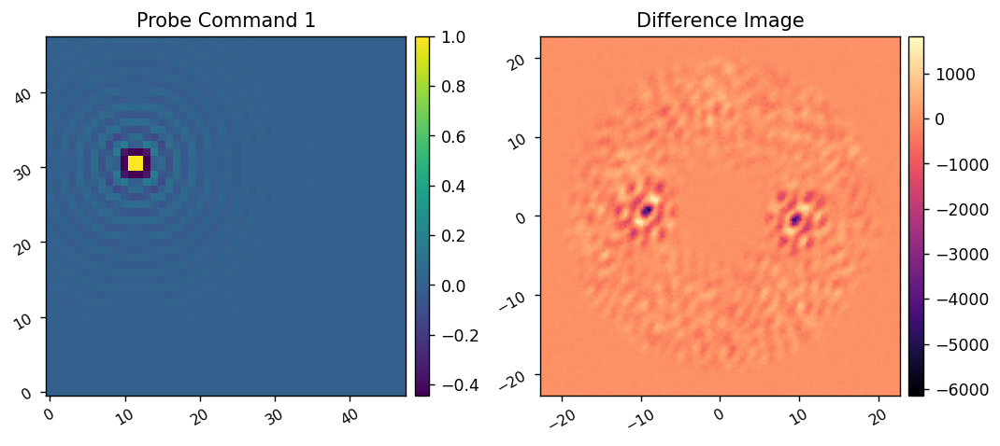

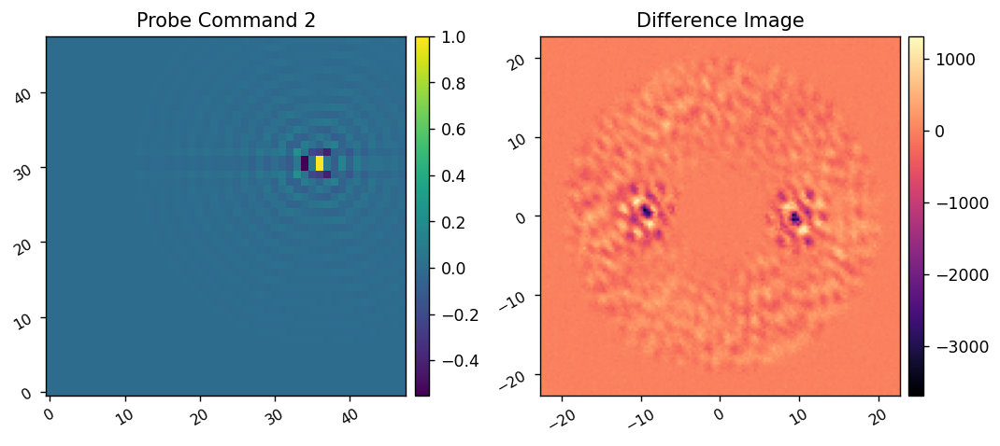

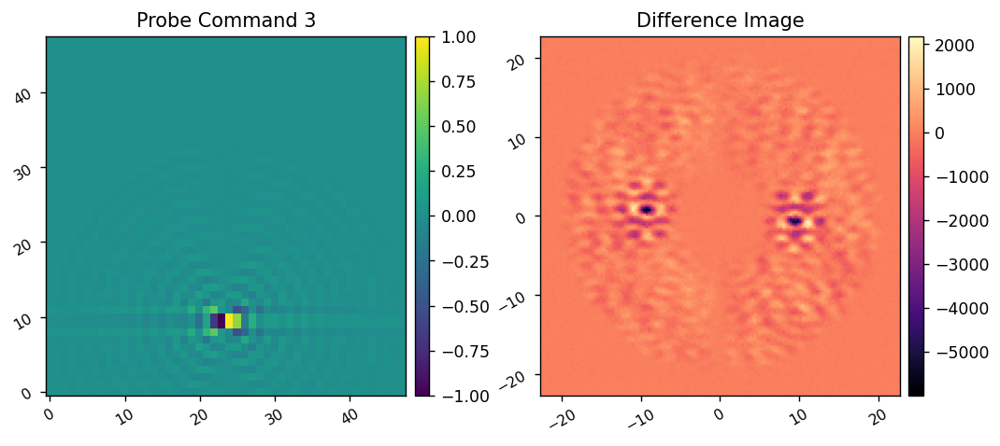

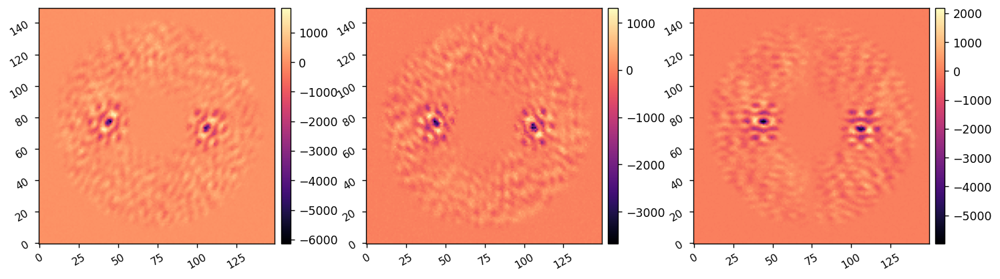

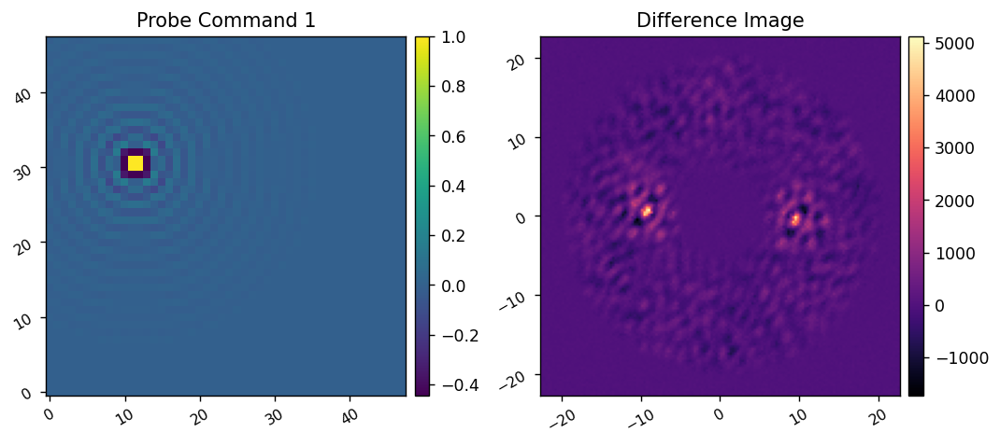

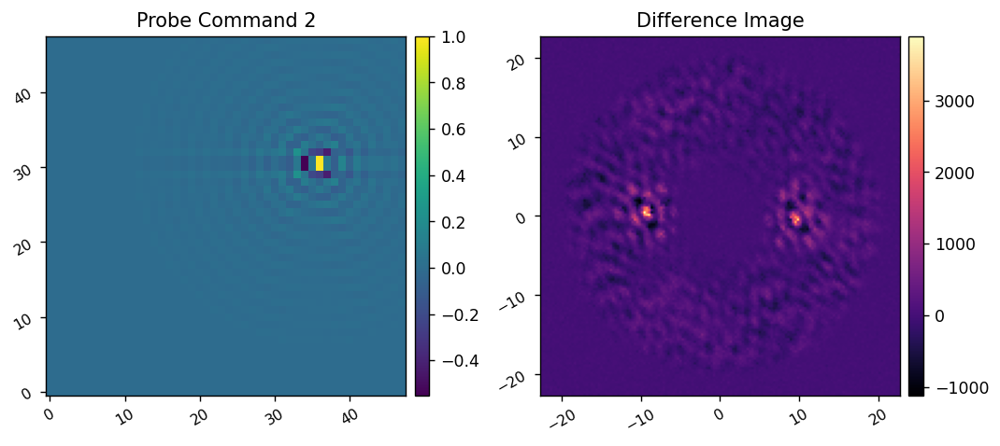

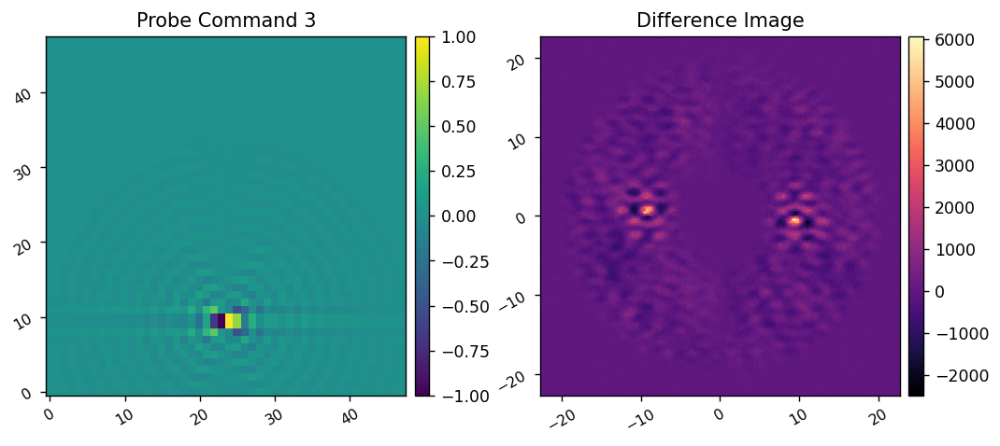

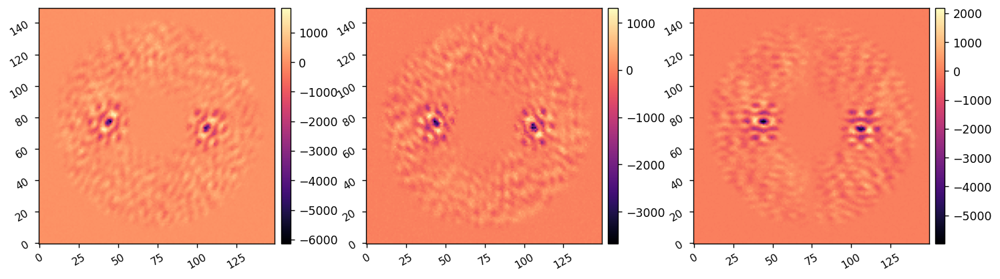

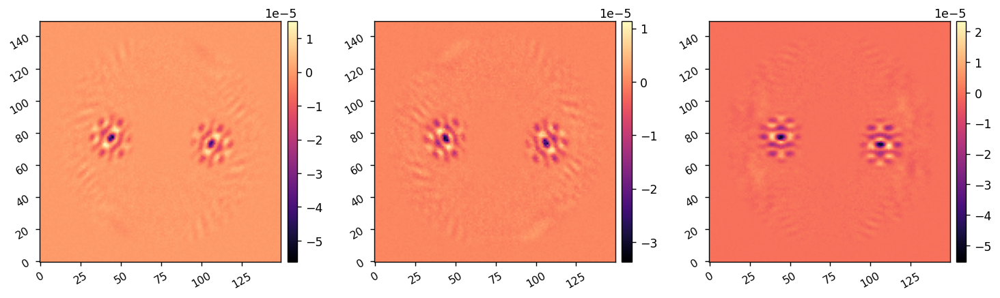

In [19]:
reload(iefc_2dm)

i = 420

scaled_calib_amp = calib_amp*scale_factors[i]
dm_mode = calib_modes[i,:mode.Nact**2].reshape(mode.Nact,mode.Nact)

mode.add_dm1(scaled_calib_amp* dm_mode)
differential_images, single_images = iefc_2dm.take_measurement(mode, probe_modes, probe_amp, return_all=True, plot=True)
diff_ims1 = differential_images.reshape(probe_modes.shape[0], mode.npsf, mode.npsf)
mode.add_dm1(-scaled_calib_amp*dm_mode)
imshow3(diff_ims1[0], diff_ims1[1], diff_ims1[2])

mode.add_dm1(-scaled_calib_amp* dm_mode)
differential_images, single_images = iefc_2dm.take_measurement(mode, probe_modes, probe_amp, return_all=True, plot=True)
diff_ims2 = differential_images.reshape(probe_modes.shape[0], mode.npsf, mode.npsf)
mode.add_dm1(+scaled_calib_amp*dm_mode)
imshow3(diff_ims1[0], diff_ims1[1], diff_ims1[2])

responses = 2*calib_amp*(diff_ims1-diff_ims2)
imshow3(responses[0], responses[1], responses[2])


Calibrating iEFC...


	Calibrated mode 1/3 in 12.062s
		Scale Factor = 1.00, Calibration amplitude = 2.50e-09m
	Calibrated mode 2/3 in 24.096s
		Scale Factor = 1.00, Calibration amplitude = 2.50e-09m
	Calibrated mode 3/3 in 36.125s
		Scale Factor = 1.00, Calibration amplitude = 2.50e-09m

Calibration complete.


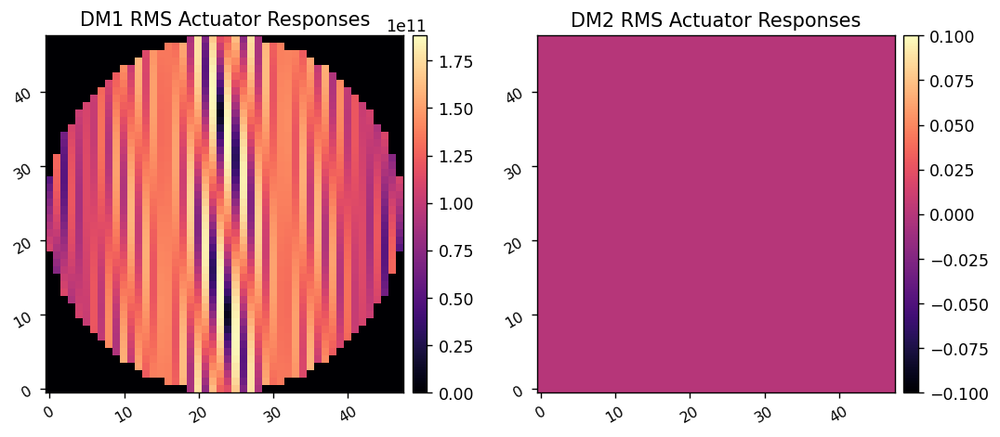

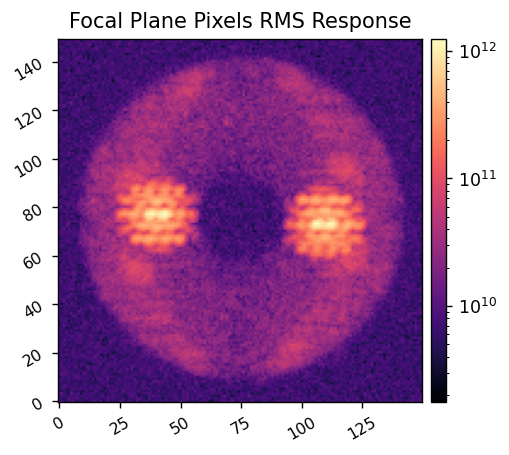

Saved data to:  /home/kianmilani/Projects/roman-cgi-iefc-data/response-data/test_response_matrix_20240104.fits


In [20]:
reload(iefc_2dm)

# calib_amp = 5e-9

response_matrix, response_cube, calib_amps = iefc_2dm.calibrate(mode, 
                                                                control_mask,
                                                                probe_amp, probe_modes, 
                                                                calib_amp, calib_modes[420:423], 
                                                                scale_factors=scale_factors[420:423], 
                                                                return_all=True, 
            #                                                     plot_responses=False,
                                                            )

utils.save_fits(response_dir/f'test_response_matrix_{today}.fits', response_matrix)
# utils.save_fits(response_dir/f'test_response_cube_{today}.fits', response_cube)


In [10]:
date = 20230912
date = 20230913
date = 20230918
date = 20230920
# date = 20230921
date = 20231017
date = 20231220 # hadamard modes
date = 20231222 # fourier modes
date = 20231224 # fourier modes 2
date = 20240104
response_matrix = xp.array(fits.getdata(response_dir/f'spc_wide_band4b_emccd_response_matrix_{date}.fits'))
response_info = fits.getheader(response_dir/f'spc_wide_band4b_emccd_response_matrix_{date}.fits')
display(response_info)
# response_cube = xp.array(fits.getdata(data_dir/response_dir/f'spc_wide_825_poke_modes_response_cube_{date}.fits'))

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -64 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                 3480                                                  
NAXIS2  =                40572                                                  
EM_GAIN =                  250                                                  

In [11]:
response_matrix.shape

dm_response = xp.sqrt(xp.mean(response_matrix.dot(xp.array(calib_modes))**2, axis=0))
dm1_response = dm_response[:mode.Nact**2].reshape(mode.Nact, mode.Nact)/dm_response.max()
dm2_response = dm_response[mode.Nact**2:].reshape(mode.Nact, mode.Nact)/dm_response.max()

print(dm_response.max())
imshow2(dm1_response, dm2_response, 
        'RMS Response of DM1\nActuators with Hadamard Modes', 'RMS Response of DM2\nActuators with Hadamard Modes',
        lognorm=True, vmin1=0.01, vmin2=0.01,
        )


nan


ValueError: Invalid vmin or vmax

Error in callback <function _draw_all_if_interactive at 0x7f151687b6a0> (for post_execute):


ValueError: vmin must be less or equal to vmax

ValueError: vmin must be less or equal to vmax

<Figure size 1250x500 with 3 Axes>

# Run IEFC

In [21]:
mode.reset_dms()
images = xp.array([ref_im])
dm1_commands = xp.array([mode.get_dm1()])
dm2_commands = xp.array([mode.get_dm2()])
regs = xp.array([])

# imshow2(mode.get_dm1(), mode.get_dm2())

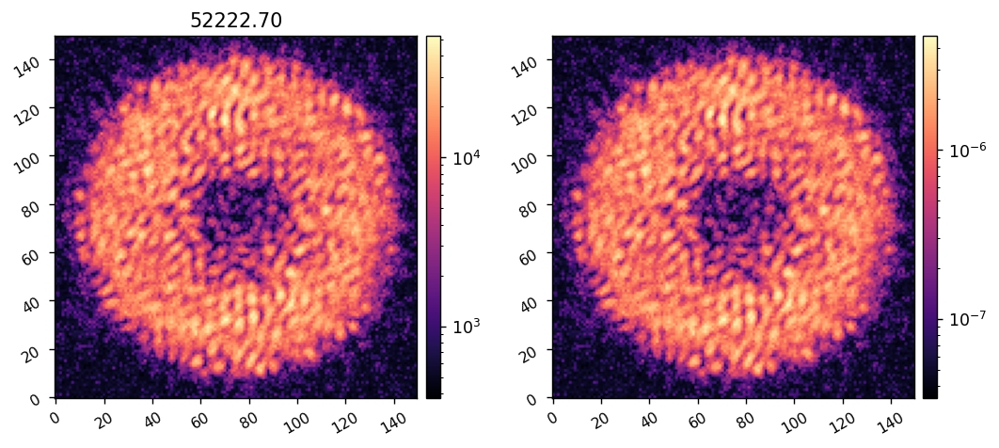

In [45]:
mode.normalize = True

mode.exp_time = 3
mode.Nframes = 10
mode.EMCCD.em_gain = 250

probe_amp = 10e-9

mode.add_dm1(probe_amp*probe_modes[0])
im = mode.snap()
mode.add_dm1(-probe_amp*probe_modes[0])

imshow2(im/mode.norm_factor, im, f'{xp.max(im/mode.norm_factor):.2f}', lognorm=True,)

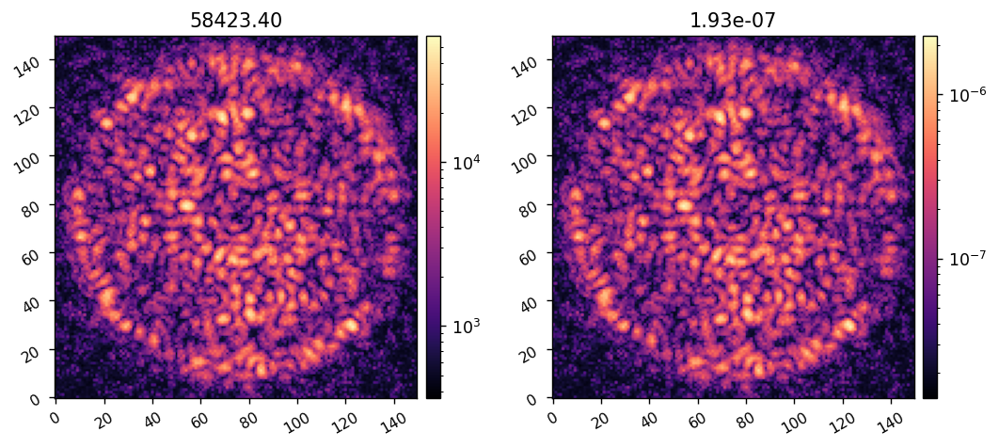

In [47]:

mode.exp_time = 7
mode.Nframes = 10
mode.EMCCD.em_gain = 250

im = mode.snap()
mean_ni = xp.mean(im[control_mask])
imshow2(im/mode.norm_factor, im, 
        f'{xp.max(im/mode.norm_factor):.2f}',
        f'{mean_ni:.2e}',
         lognorm=True,)


In [42]:
reg_fun = utils.beta_reg
reg_conds = -3

Running iEFC...
	Closed-loop iteration 16 / 18


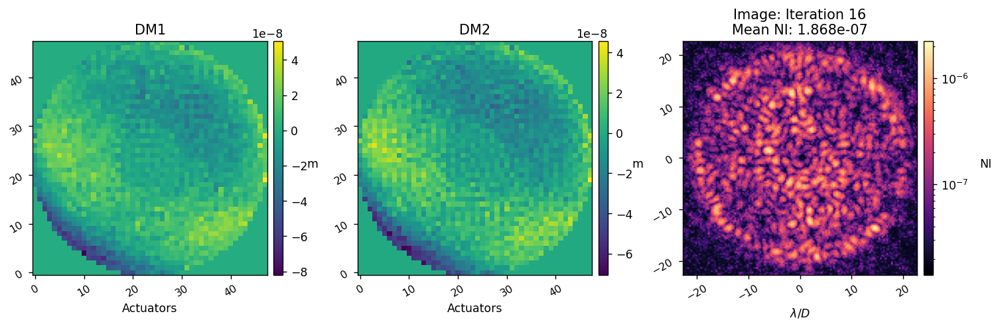

	Closed-loop iteration 17 / 18


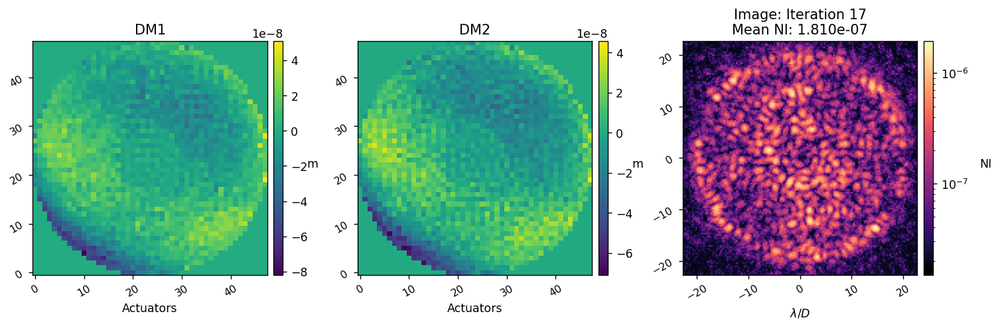

	Closed-loop iteration 18 / 18


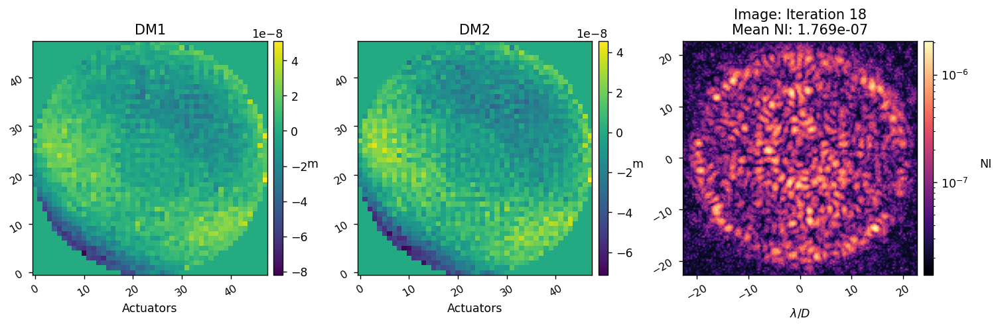

Closed loop for given control matrix completed in 23.450s.


In [48]:
reload(iefc_2dm)
reload(utils)

images, dm1_commands, dm2_commands, regs = iefc_2dm.run(mode, 
                                                        response_matrix,
                                                        reg_fun, reg_conds, 
                                                        probe_modes, 
                                                        probe_amp, 
                                                        calib_modes,
                                                        control_mask, 
                                                        num_iterations=3, 
                                                        loop_gain=0.5, 
                                                        leakage=0,
                                                        probe_exp_time=3,
                                                        probe_nframes=10,
                                                        probe_em_gain=250,
                                                        metric_exp_time=7,
                                                        metric_nframes=10,
                                                        metric_em_gain=250,
                                                        plot_all=True,
                                                        plot_radial_contrast=False,
                                                        old_images=images,
                                                        old_dm1_commands=dm1_commands,
                                                        old_dm2_commands=dm2_commands,
                                                        old_regs=regs,
                                              )

In [147]:
utils.save_fits(response_dir/f'spc_wfov_band4b_emccd_dm1_commands_{today}.fits', dm1_commands)
utils.save_fits(response_dir/f'spc_wfov_band4b_emccd_dm2_commands_{today}.fits', dm2_commands)
utils.save_fits(response_dir/f'spc_wfov_band4b_emccd_images_{today}.fits', images)
utils.save_fits(response_dir/f'spc_wfov_band4b_emccd_regs_{today}.fits', regs)

Saved data to:  /home/kianmilani/Projects/roman-cgi-iefc-data/response-data/spc_wfov_band4b_emccd_dm1_commands_20231221.fits
Saved data to:  /home/kianmilani/Projects/roman-cgi-iefc-data/response-data/spc_wfov_band4b_emccd_dm2_commands_20231221.fits
Saved data to:  /home/kianmilani/Projects/roman-cgi-iefc-data/response-data/spc_wfov_band4b_emccd_images_20231221.fits


AttributeError: 'list' object has no attribute 'get'